In [88]:
%load_ext autoreload
%autoreload 2


import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
from sklearn.mixture import GaussianMixture
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr
from tqdm.notebook import tqdm
from diptest import diptest
from scipy.sparse import csr_matrix
import anndata as ad
import math


from utils import preprocessing

# Hyperparamyters
LIBRARY = "H3"


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Goals

- QC metrics
- Plot cell type annotaions

# Load Adata

In [53]:
ADATA_PATH = f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/labelled_adata.h5ad'
adata = sc.read_h5ad(ADATA_PATH)

print(adata)

AnnData object with n_obs × n_vars = 36649 × 38606
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient'
    var: 'feature_types', 'genome', 'gene_symbol'
    obsm: 'spatial'
    layers: 'counts'


# Calculate QC Metrics

In [58]:
# Calculate qc
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

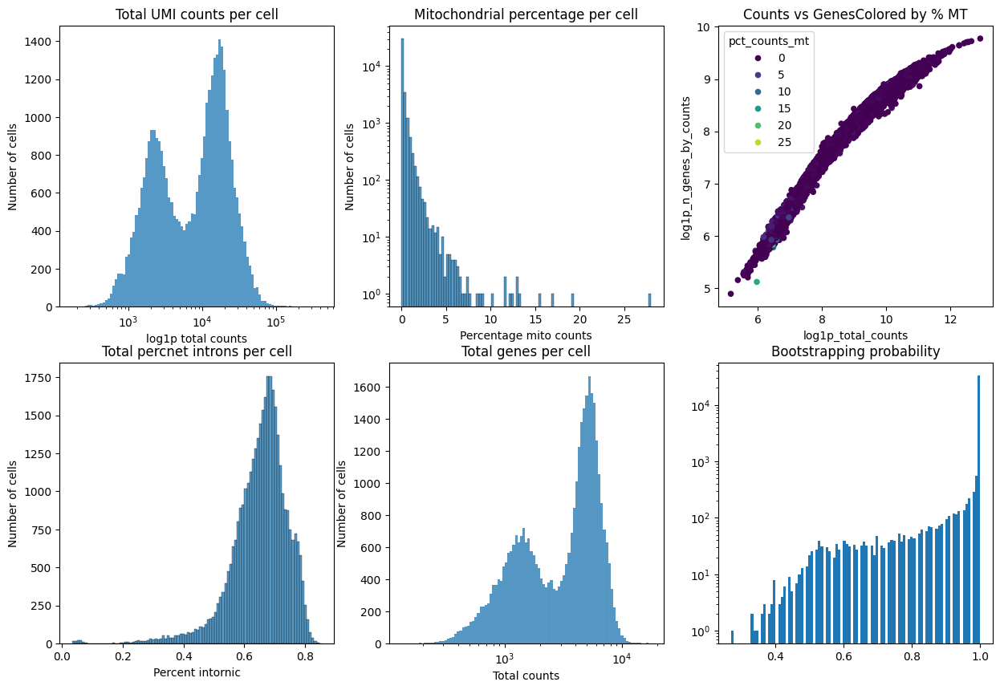

In [4]:
preprocessing.plot_qc_metrics(adata)

# Minimal Filter cells & genes

In [5]:
print(f"Starting: {adata.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': adata.obs["total_counts"] >= 500,
    'min_genes': adata.obs["n_genes_by_counts"] >= 200,
    'mt_threshold': adata.obs["pct_counts_mt"] <= 8,
    'is_cell_dropsift': adata.obs["is_cell"] == True,
    'percent_intronic_threshold': adata.obs["pct_intronic"] >= 0.25,
    'mapmycells_probs_class': (adata.obs['Class_bootstrapping_probability'] >= 0.5), # & (adata.obs['Class_correlation_coefficient'] >= 0.5),
    #'spatial_present': ~adata.obs.has_spatial,
}

# Print individual filter stats
n_start = len(adata)
for name, filt in filters.items():
    removed = (~filt).sum()
    print(f"{name:30s}: {removed:6,} removed ({100*removed/len(adata):5.1f}%)")

# Replace adata
cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
adata = adata[cells_to_keep].copy()

print(f"Final: {adata.n_obs:,} / {n_start:,} cells retained ({100*adata.n_obs/n_start:.1f}%)")

Starting: 36,649 cells

min_UMI                       :    109 removed (  0.3%)
min_genes                     :      9 removed (  0.0%)
mt_threshold                  :     15 removed (  0.0%)
is_cell_dropsift              :    877 removed (  2.4%)
percent_intronic_threshold    :    192 removed (  0.5%)
mapmycells_probs_class        :     94 removed (  0.3%)
Final: 35,576 / 36,649 cells retained (97.1%)


In [6]:
# Filter genes
print(f"   Genes before filtering: {adata.n_vars}")
sc.pp.filter_genes(adata, min_cells=3)
print(f"   Genes after filtering: {adata.n_vars}")

   Genes before filtering: 38606
   Genes after filtering: 34115


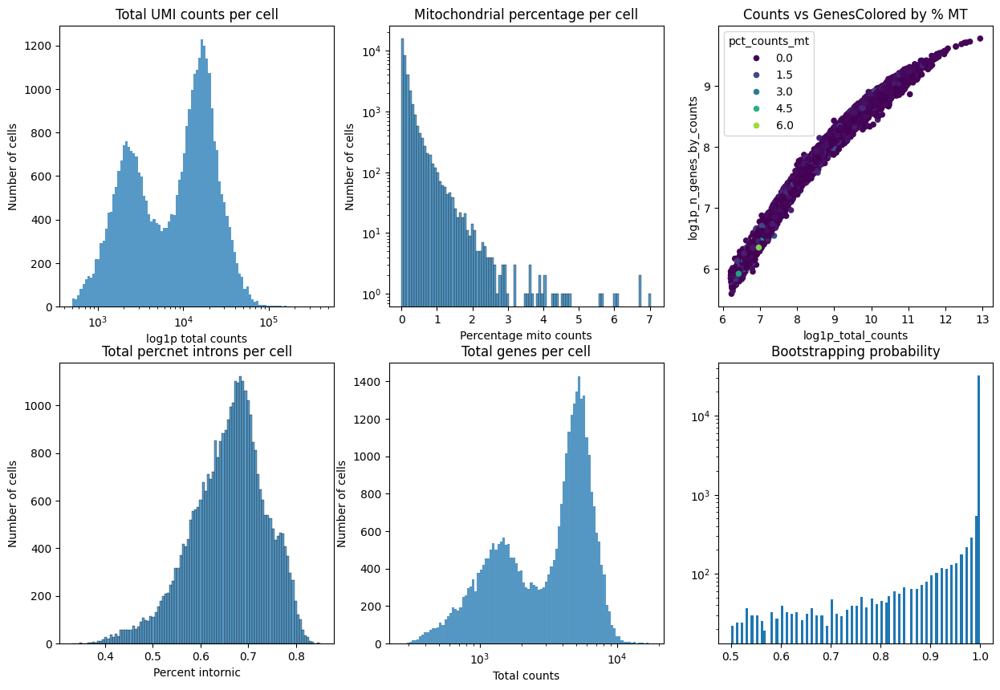

In [7]:
preprocessing.plot_qc_metrics(adata)

# Processing Pipeline

Normalizing...
Findingn HCGs...


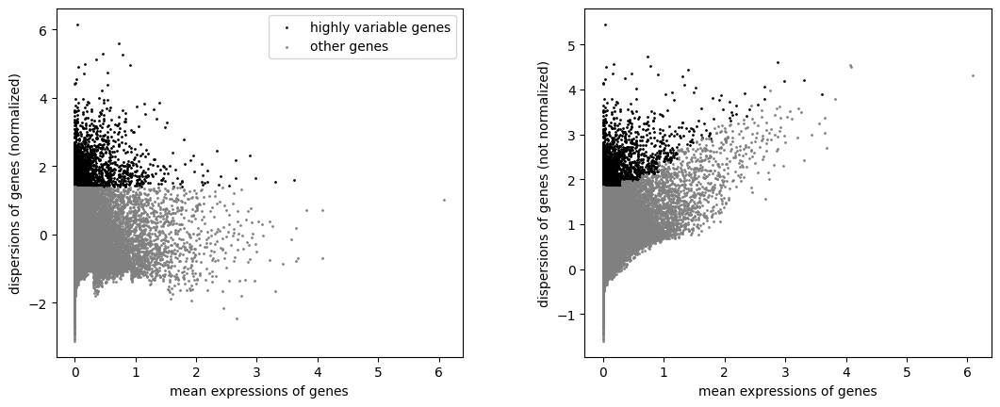

Scaling...


/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...


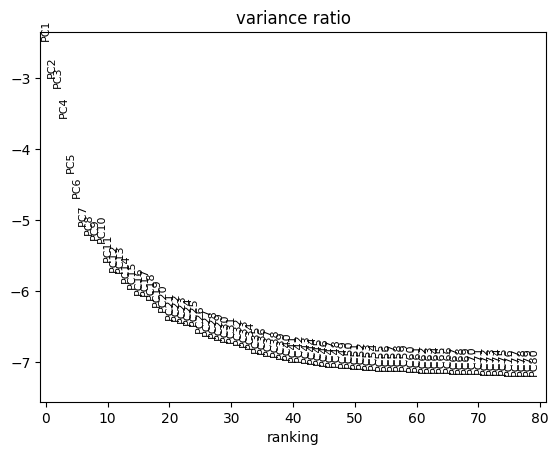

Calculating neightbors...
Calculating Umap...
Clutering...


In [8]:
preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

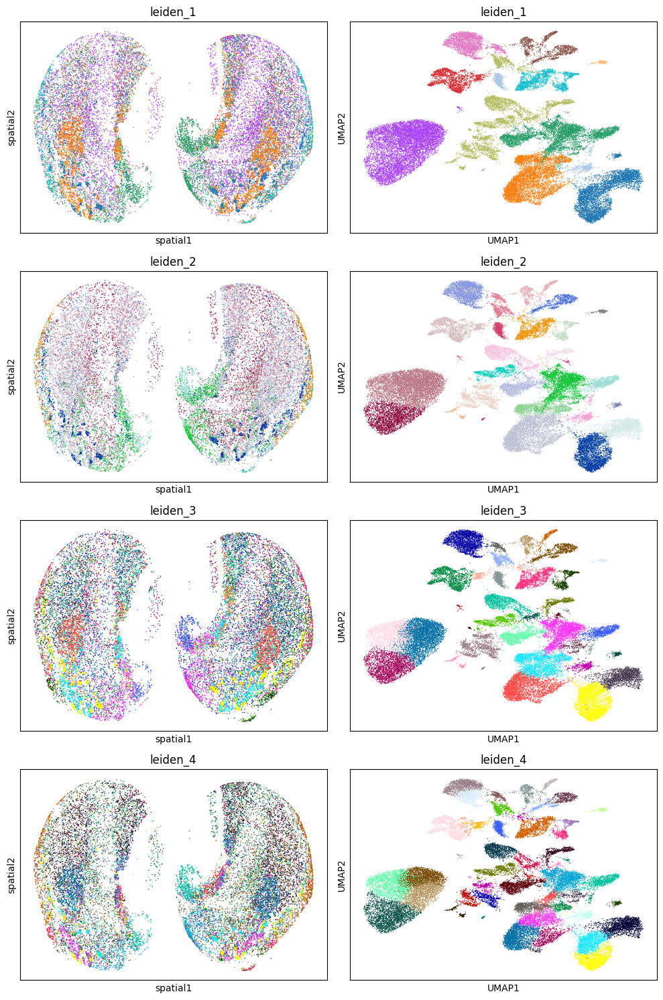

In [16]:
# Plor ledein clistering

fig, axes = plt.subplots(4, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Investigate PCs

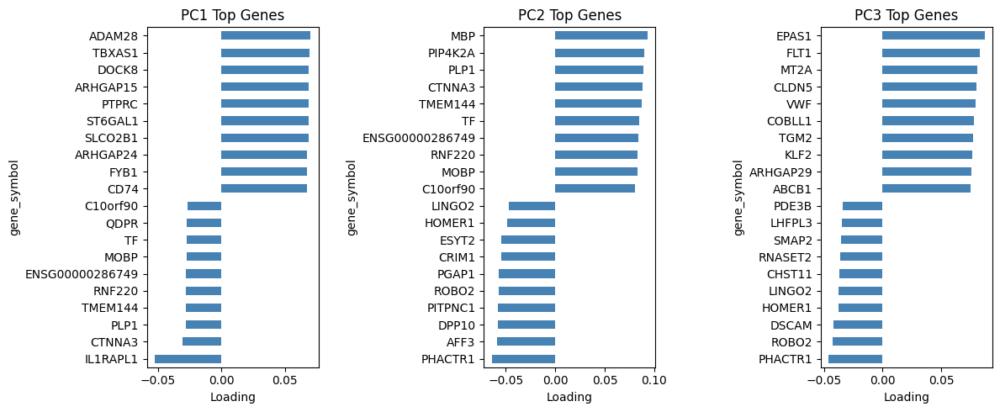

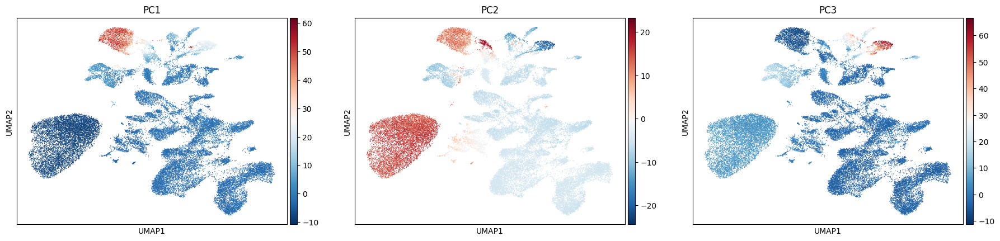

In [13]:
preprocessing.show_top_pc_genes(adata, n_pcs=3, top_n=10)

**PC1: Oligodendrocytes ↔ Neurons**

Positive (Neuronal):
  CELF2, ARHGAP26, KCNMA1, SLC8A1, NEBL
  → Neuronal genes (ion channels, synaptic)

Negative (Oligodendrocyte):
  PLP1 (-0.058) ← MAJOR myelin gene!
  APOD, LAMA2
  → Oligodendrocyte/myelin genes

**PC2: Astrocytes vs Oligodendrocytes**

Positive (Astrocytes):
AQP4, SLC1A2, ATP1A2, ETNPPL = Classic astrocyte markers

Negative (Oligodendrocytes):
MBP, MOG, MOBP, PLP1, TF = Myelin genes (oligodendrocytes)

**PC3: Microglia vs Astrocytes**

Positive (Microglia/Immune):
CD74, PTPRC (CD45), CSF1R, INPP5D = Microglia/immune cell markers

Negative (Astrocytes):
Same astrocyte genes from PC2
  → Canonical astrocyte markers

# Save Minimal filtered Adata

In [14]:
adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')
del(adata)

In [59]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/minimal_filtered_adata.h5ad')

# QC metrics on umap

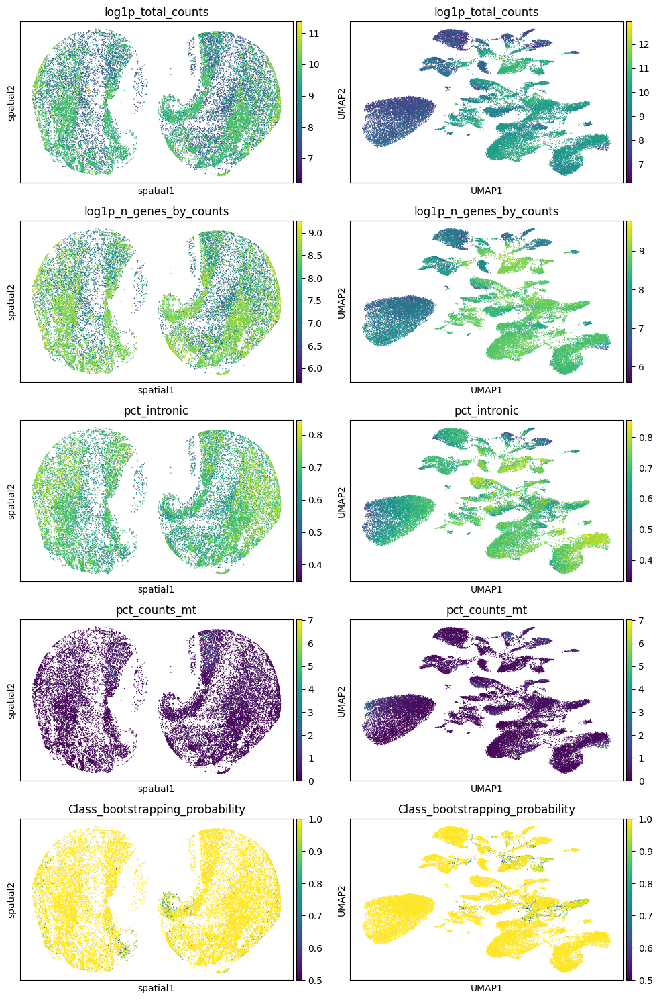

In [17]:
fig, axes = plt.subplots(5, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["log1p_total_counts", "log1p_n_genes_by_counts", "pct_intronic", "pct_counts_mt", "Class_bootstrapping_probability"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Metrics by Cluster

## Select label resolution

In [18]:
# CLUSTER_LEVEL = "leiden_4"
# ANNOTATION_LEVEL = "Subclass_name"

# fig, axes = plt.subplots(2, 2, figsize=(20, 14))

# for i, res in enumerate(["leiden_4", "Group_name"]):
#     sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
#     sc.pl.embedding(adata, basis="X_umap", color=res, ax=axes[i,1], show=False, legend_fontsize=10, size=8, legend_loc="on data",)# legend_loc="lower center")

# plt.tight_layout()
# plt.show()

## QC metrics by clusters

In [19]:
# metrics = [
#     "total_counts",
#     "n_genes_by_counts",
#     "pct_intronic",
#     "pct_counts_mt",
#     "Class_bootstrapping_probability",
# ]

# # compute mean of each metric for each cluster
# df_means = (
#     adata.obs
#     .groupby(CLUSTER_LEVEL, observed=False)[metrics]
#     .mean()
#     .reset_index()
# )


# df_means = df_means.set_index(CLUSTER_LEVEL)
# # display(df_means)

# # Plot
# fig, axes = plt.subplots(2, 3, figsize=(20, 8))
# axes = axes.flatten()

# for ax, col in zip(axes, metrics):
#     df_means[col].plot(kind="bar", ax=ax)
#     ax.set_title(col)
#     ax.set_ylabel("mean")
#     ax.tick_params(axis="x")#, rotation=45)

# # hide any unused axes
# for ax in axes[len(metrics):]:
#     ax.set_visible(False)

# plt.tight_layout()
# plt.show()


# # sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data")


## UMI counts distribution by cluster

In [20]:
# # Get unique clusters
# clusters = adata.obs[CLUSTER_LEVEL].unique()

# n_clusters = len(clusters)
# ncols = 5
# nrows = int(np.ceil(n_clusters / ncols))

# fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
# axes = axes.flatten()

# for idx, cluster in enumerate(clusters):
#     ax = axes[idx]
    
#     # Get data for this cluster
#     cluster_data = adata.obs[adata.obs[CLUSTER_LEVEL] == cluster]['total_counts']
    
#     # Plot histogram
#     ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
#     ax.set_title(f'Cluster {cluster}', fontweight='bold')
#     ax.set_xlabel('Total Counts')
#     ax.set_ylabel('# Cells')
    
#     # Add mean line
#     mean_val = cluster_data.mean()
#     ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
#                label=f'Mean: {mean_val:.0f}')
    
#     # Same x-axis for all
#     #ax.set_xlim(global_min, global_max)
#     ax.legend(fontsize=8)
#     ax.grid(alpha=0.3)

# # Hide unused subplots
# for idx in range(n_clusters, len(axes)):
#     axes[idx].axis('off')

# plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
# plt.tight_layout()
# plt.show()

## Cell Type distribution by cluster

In [21]:
# preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Class_name", CLUSTER_LEVEL=CLUSTER_LEVEL)
# preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Subclass_name", CLUSTER_LEVEL=CLUSTER_LEVEL)

## Cell Type distribution on Umap/spatial

In [22]:
# preprocessing.plot_cell_type(adata, ANNOTATION_LEVEL=ANNOTATION_LEVEL)

## Overall cell type distribution

In [23]:
# preprocessing.plot_cell_type_distribution(adata, annotation_levels=["Class_name", "Group_name"])

# Cell type markers

In [24]:
markers = {
    # Non-neuronal cells
    'Astrocyte': ['GFAP', 'AQP4', 'GINS3'],
    
    'Ependymal': ['ZBBX'],
    
    'Endothelial': ['DCN', 'FLT1'],
    
    'Lymphocyte': ['SKAP1', 'THEMIS'],
    
    'Microglia': ['CX3CR1', 'P2RY12', 'C1QA', 'C1QB', 'C1QC'],
    
    'Macrophage': ['CD163', 'CD200R1'],
    
    'Oligodendrocyte': ['MOBP', 'MBP', 'PLP1'],# 'SHROOM4', 'TF'],
    
    'OPC': ['VCAN', 'PDGFRA'],
    
    # Neurons - using ONLY subtype-specific markers (no RBFOX3/SYT1 overlap)
    'Neuron_inhibitory': ['GAD1', 'GAD2', 'SLC32A1'],
    
    'Neuron_excitatory': ['SLC17A6', 'SLC17A7', 'SLC17A8'],
    
    'Neuron_dopaminergic': ['SLC6A3', 'TH'],
    
    'Neuron_cholinergic': ['CHAT'],
    
    'Neuron_serotonergic': ['SLC6A4'],
}

mapping_genes_name_dict = adata.var[["gene_symbol"]].to_dict()["gene_symbol"].copy()
symbol_to_varid = {v.upper(): k for k, v in mapping_genes_name_dict.items() if isinstance(v, str)}
translated_markers = {
    celltype: [symbol_to_varid.get(gene.upper(), None) for gene in genes]
    for celltype, genes in markers.items()
}

display(translated_markers)


{'Astrocyte': ['ENSG00000131095', 'ENSG00000171885', 'ENSG00000181938'],
 'Ependymal': ['ENSG00000169064'],
 'Endothelial': ['ENSG00000011465', 'ENSG00000102755'],
 'Lymphocyte': ['ENSG00000141293', 'ENSG00000172673'],
 'Microglia': ['ENSG00000168329',
  'ENSG00000169313',
  'ENSG00000173372',
  'ENSG00000173369',
  'ENSG00000159189'],
 'Macrophage': ['ENSG00000177575', 'ENSG00000163606'],
 'Oligodendrocyte': ['ENSG00000168314', 'ENSG00000197971', 'ENSG00000123560'],
 'OPC': ['ENSG00000038427', 'ENSG00000134853'],
 'Neuron_inhibitory': ['ENSG00000128683',
  'ENSG00000136750',
  'ENSG00000101438'],
 'Neuron_excitatory': ['ENSG00000091664',
  'ENSG00000104888',
  'ENSG00000179520'],
 'Neuron_dopaminergic': ['ENSG00000142319', 'ENSG00000180176'],
 'Neuron_cholinergic': ['ENSG00000070748'],
 'Neuron_serotonergic': ['ENSG00000108576']}

## Plot single markers expression

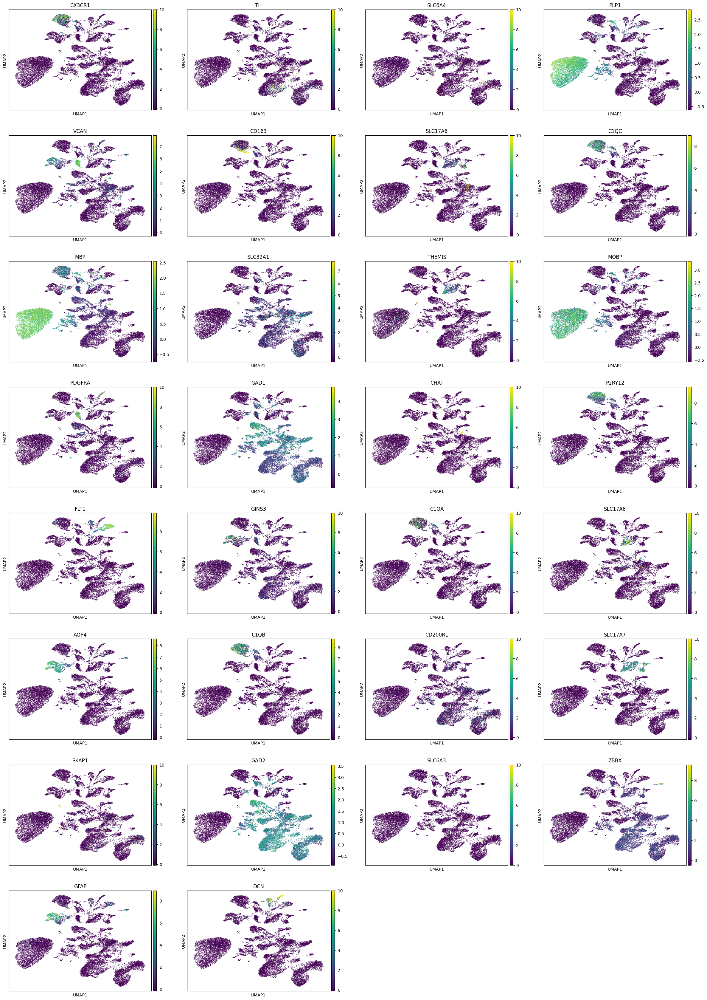

In [25]:
gene_to_plot = set()
for key, item in markers.items():
    gene_to_plot.update(set(item))
    
sc.pl.umap(adata, color=gene_to_plot, cmap='viridis', ncols=4, gene_symbols="gene_symbol")#, vmin=-1, vmax=1)


## Plot Module score markers

  0%|          | 0/13 [00:00<?, ?it/s]

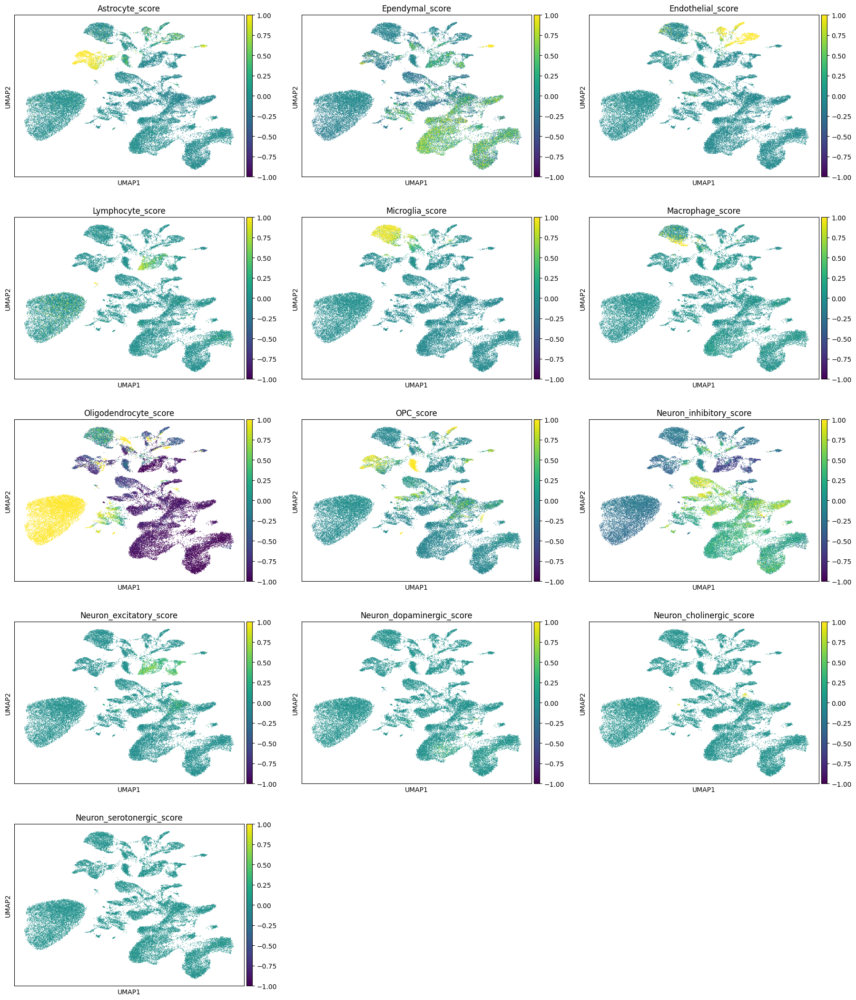

In [26]:
for cell_type, genes in tqdm(translated_markers.items()):
    # Only use genes that exist in your data
    #genes_available = [g for g in genes if g in adata.var.gene_symbol.to_list()]
    
    if len(genes) > 0:
        #print(f"  {cell_type}: {len(genes)} markers")
        sc.tl.score_genes(adata, genes, score_name=f'{cell_type}_score', use_raw=False, layer="log1p_norm") # normalised scores (not scaled)
    else:
        print(f"  ⚠ {cell_type}: No markers found!")

# plot umaps
score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]
sc.pl.umap(adata, color=score_cols, cmap='viridis', ncols=3, vmin=-1, vmax=1)

## Plot Oligos Markers

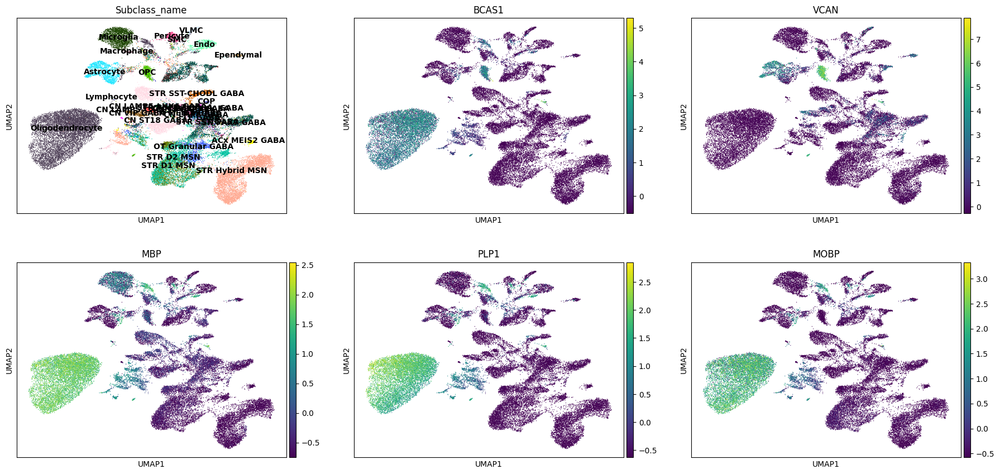

In [27]:
# Check if they're differentiating OPCs (real) or doublets (artifact)
#(Oligo + OPC)
# REAL BIOLOGY (good) ✓
# OPC differentiating into Oligodendrocyte
# → Transition state, should KEEP!
#  BCAS1 expression (differentiation marker) --> BCAS1 high → Real differentiating cells → KEEP ✓
sc.pl.umap(adata, color=['Subclass_name', 
                         'BCAS1',  # differentiationg
                         'VCAN', # OPC
                         'MBP', 'PLP1', 'MOBP' # Mature Oligo
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

## Plot Neun Markers

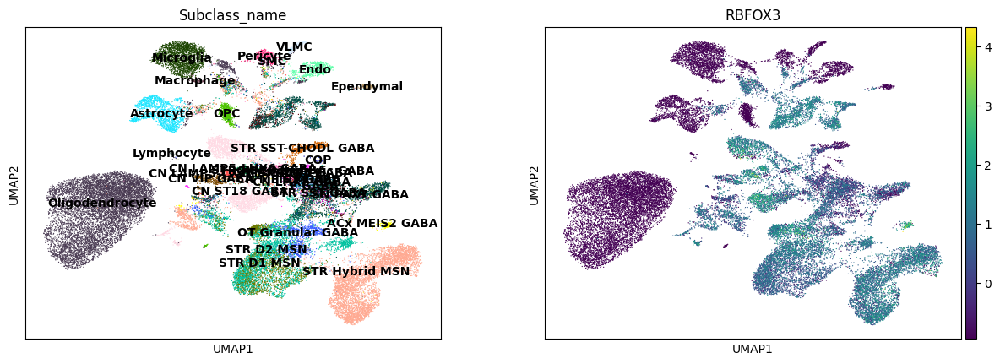

In [28]:
sc.pl.umap(adata, color=['Subclass_name', 
                         'RBFOX3', 
                         ], gene_symbols="gene_symbol", ncols=3, legend_loc="on data")

# Remove Doublets clusters

excluding cell clusters that co-express marker genes of distinct cell types (not UMI based approach).

Problem: Homotypic doublets (formed by transcriptionally similar cells) cannot be detected this way

Check if the doublet cluster is positioned between its "parent" clusters in UMAP space

3 Different Approaches:
- find DEGs for each cluster, if a cluster has DEGs that belongs to 2 differt cell types, then it is a doublet
- calculate module score of marker genes for each cell type, if a cluster has high score for more thna one cell type(entropy), then it is a doublet
- **THE ONE USED**: just oligo doublets. Mark as doublets all cells that:
    - have high module score for oligo cell type
        - thr is found: by plotting oligo_module_score for each cluster (that is not in oligo-blob) and in cluster that have bimodal distrubtion, search common thr
        - mean all thr found 
        - a cell is doublet if the oligo score is biggenr than this mean thr
    - are not in the big "blob" of real oligos cells

## Putative Doublets by gene Markers

Find gene makers (DEGs) for each cluster and see if they are ibtersection with makrher genes of a specific cell type.

If they overlap wiht more than 2 cell types they coudl be doublets.

In [38]:
# # Find marker genes for each cluster (equivalent to FindAllMarkers)
#     # need log normlsied data --< NPY scaled
#     # DEG: cluster Vs rest
# sc.tl.rank_genes_groups(
#     adata, 
#     groupby=CLUSTER_LEVEL, 
#     method='wilcoxon', 
#     reference="rest", 
#     corr_method="benjamini-hochberg",
#     use_raw=False, 
#     layer="log1p_norm", #ATTNETION: NOT scaled data in X
#     pts = True, # ATTENTION; % cells expressing gene IN and OUT cluster 
# )

In [39]:
# # Get top genes as DataFrame
# top_n = 300
# doublet_clusters_markers = {}

# for cluster in tqdm(adata.obs[CLUSTER_LEVEL].cat.categories):

#     # Get top genes for this cluster
#     df = sc.get.rank_genes_groups_df(adata, group=cluster) # sorted by score

#     df = df[
#         (df.pvals_adj < 0.05) &
#         (df.logfoldchanges > 1) &
#         (df.scores > 0) &
#         (df['pct_nz_group'] > 0.25) &  # only test genes that are detected in a minimum fraction  IN cluster
#         # (df['pct_nz_reference'] < 0.50) & # only test genes NOT expressed outside
#         # ((df['pct_nz_group'] - df['pct_nz_reference']) > 0.10) # Gene must be >10% more frequent in cluster than outside  
#     ] 


#     #display(df)
#     top_genes = set(df.head(top_n)['names'].tolist())
#     #print(top_genes)

#     # check if these top genes overlpa wiht one of the gene list of a specific cell type
#     cell_types_found = {}
#     for cell_type, cell_type_markers in translated_markers.items(): # ATTENTION: gene name
#         overlap = top_genes & set(cell_type_markers)
#         if len(overlap) != 0:
#             cell_types_found[cell_type] = list(overlap)

#     if len(cell_types_found.keys()) >= 2:
#         doublet_clusters_markers[cluster] = list(cell_types_found.keys())


# display(doublet_clusters_markers)


# fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# for ax, g in zip(axes, [list(doublet_clusters_markers.keys()), 
#                     ['6', '7', '11', '12', '22', '29', '33', '34', '36', '48', '50', '52', '54', '55', '58']]# clusters with very differt cell types
#                     ): 
#     sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
#                     groups=g, ax=ax, show=False, return_fig=False)
# plt.tight_layout(); plt.show()




## Putative Doublets by Module score and Entropy

FOr each cell tyope marker genes lists, calculate the relative module socre (for each cell).

Calculate mean module score for each cluster for each module.

Claulte Entropy of these menas per cluster.

CLusters wiht high entropy (mix of modules) are doublets.

In [40]:
# # plot moduels per cluster
# # Get mean scores per cluster
# cluster_scores = adata.obs.groupby(CLUSTER_LEVEL, observed=False)[score_cols].mean()

# # Clean column names
# cluster_scores.columns = [c.replace('_score', '') for c in cluster_scores.columns]

# # Simple barplot - one per cluster
# n_clusters = len(cluster_scores)
# ncols = 6
# nrows = int(np.ceil(n_clusters / ncols))

# fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3*nrows))
# axes = axes.flatten() if n_clusters > 1 else [axes]

# for idx, (cluster, row) in enumerate(cluster_scores.iterrows()):
#     ax = axes[idx]
    
#     # Sort values for easier reading
#     sorted_data = row.sort_values(ascending=True)
    
#     # Plot
#     ax.barh(range(len(sorted_data)), sorted_data.values, color='steelblue')
#     ax.set_yticks(range(len(sorted_data)))
#     ax.set_yticklabels(sorted_data.index, fontsize=8)
#     ax.set_xlabel('Mean Module Score', fontsize=9)
#     ax.set_title(f'Cluster {cluster}', fontweight='bold')
#     ax.axvline(0, color='black', linestyle='--', linewidth=0.8)
#     ax.grid(axis='x', alpha=0.3)
#     ax.set_xlim((-0.2, 1))
#     ax.axvline(0.4, linestyle='--', linewidth=1, color="red")

# # Hide empty subplots
# for idx in range(n_clusters, len(axes)):
#     axes[idx].axis('off')

# plt.tight_layout()
# plt.show()

In [41]:
# from scipy.stats import entropy

# # Calculate entropy for each cluster (higher = more mixed)
# cluster_scores_entropy = cluster_scores.copy()
# cluster_scores_entropy['entropy'] = cluster_scores.apply(
#     lambda x: entropy(x[x > 0] / x[x > 0].sum()) if (x > 0).sum() > 1 else 0,  # clauclte onyl for vlaues bogger than 0
#     axis=1
# )

# # Flag top 25% as potential doublets
# threshold = cluster_scores_entropy['entropy'].quantile(0.75)
# high_entropy_clusters = cluster_scores_entropy[cluster_scores_entropy['entropy'] > threshold]

# # Plot
# cluster_scores_entropy['entropy'].sort_values(ascending=False).plot(
#     kind='bar', figsize=(12, 5), color='steelblue', title='Cluster Entropy'
# )
# plt.axhline(threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.2f}')
# plt.ylabel('Entropy (higher = doublet)')
# plt.legend()
# plt.tight_layout()
# plt.show()

# # Create doublet dictionary: cluster -> cell types with high scores
# doublet_clusters_entropy = {}
# for cluster in high_entropy_clusters.index:
#     scores = cluster_scores_entropy.loc[cluster].drop('entropy')
#     # Get cell types with scores > 0.3
#     threshold = scores.quantile(0.75) 
#     active_types = scores[scores > threshold].sort_values(ascending=False)
#     if len(active_types) >= 2:
#         doublet_clusters_entropy[cluster] = active_types.index.tolist()

# # Display results
# print("Entropy-based doublet clusters:")
# display(doublet_clusters_entropy)

# # Plot
# fig, axes = plt.subplots(1, 2, figsize=(12, 5))
# for ax, clusters in zip(axes, [list(doublet_clusters_entropy.keys()), 
#                                ['3', '5', '11', '12', '15', '19', '22', '32', '33', '45', '49', '52', '54', '55', '58']]):
#     sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
#                     groups=clusters, ax=ax, show=False)
# plt.tight_layout()
# plt.show()

## Putative Doublets by Oligo Module score

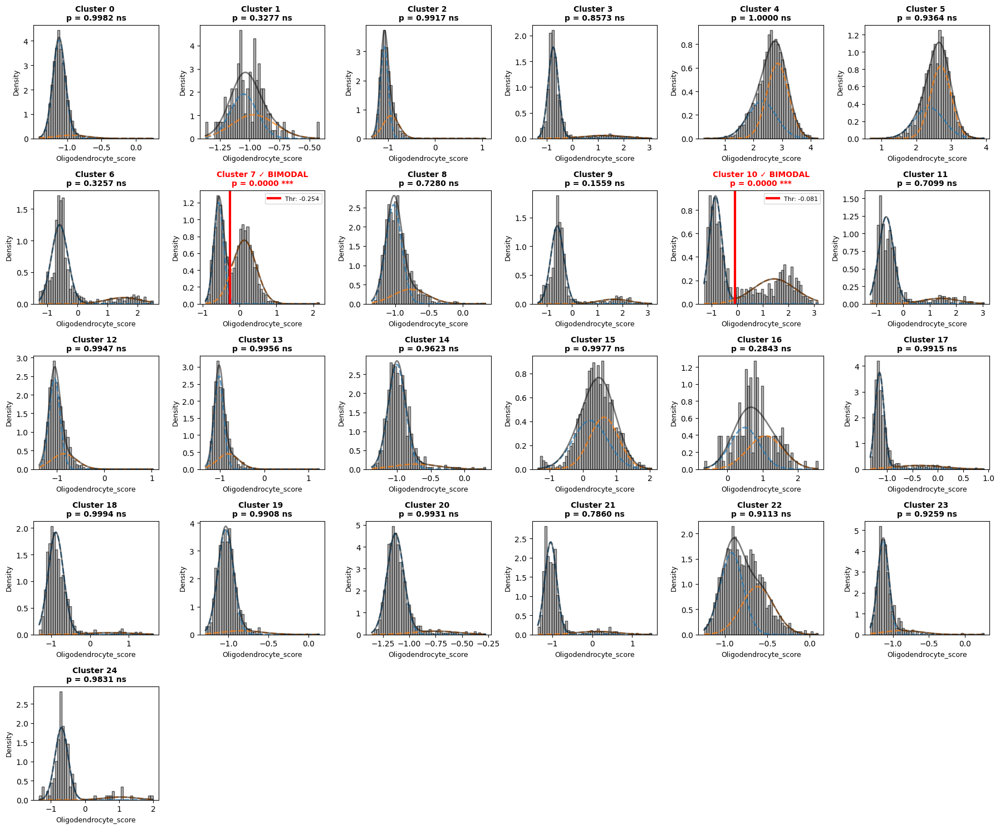

,Cluster,P_Value,Is_Bimodal,Threshold
7,7,0.000000,True,-0.254185
10,10,0.000000,True,-0.080732
9,9,0.155914,False,NaN
16,16,0.284346,False,NaN
6,6,0.325746,False,NaN
1,1,0.327689,False,NaN
11,11,0.709858,False,NaN
8,8,0.727976,False,NaN
21,21,0.785954,False,NaN
3,3,0.857266,False,NaN


{'7': -0.25418460742124094, '10': -0.08073158435754901, '9': nan, '16': nan, '6': nan, '1': nan, '11': nan, '8': nan, '21': nan, '3': nan, '22': nan, '23': nan, '5': nan, '14': nan, '24': nan, '19': nan, '17': nan, '2': nan, '20': nan, '12': nan, '13': nan, '15': nan, '0': nan, '18': nan, '4': nan}


In [29]:
score_col_oligo = "Oligodendrocyte_score"
cluster_col = "leiden_2" # need broad clustering
P_VALUE_THRESHOLD = 0.05

# get cluster names
clusters = adata.obs[cluster_col].sort_values().unique()
results = []

# Setup plot grid
ncols = 6
nrows = int(np.ceil(len(clusters) / ncols))
fig, axes = plt.subplots(nrows, ncols, figsize=(3*ncols, 15))
axes = axes.flatten()

# Analyze each cluster
for idx, cluster in enumerate(clusters):

    # Get score for this cluster
    scores = adata.obs.loc[adata.obs[cluster_col] == cluster, score_col_oligo].values
    
    # Statistical test for bimodality
    _, p_value = diptest(scores) #(H₀): The distribution is unimodal (one peak)
    is_bimodal = p_value < P_VALUE_THRESHOLD
    
    # Fit Gaussian mixture for visualization
    gmm = GaussianMixture(n_components=2, random_state=42).fit(scores.reshape(-1, 1))
    
    # Plot: score distribution, fitted gassians, and retrun valley point
    threshold = preprocessing.plot_cluster_and_get_valley(axes[idx], scores, cluster, gmm, is_bimodal, p_value, score_col_oligo)
    
    # Store results
    results.append({
        'Cluster': cluster,
        'P_Value': p_value,
        'Is_Bimodal': is_bimodal,
        'Threshold': threshold
    })

# Clean up empty subplots
for idx in range(len(clusters), len(axes)):
    fig.delaxes(axes[idx])

plt.tight_layout()
plt.show()

# Print summary
results_df = pd.DataFrame(results).sort_values('P_Value')
display(results_df.head(10))

thresholds_dict = results_df.set_index('Cluster')['Threshold'].to_dict()
print(thresholds_dict)

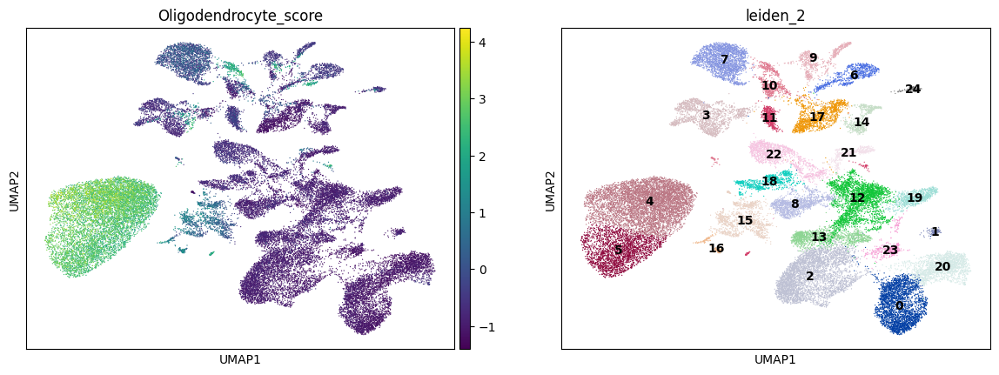

In [30]:
# Define clusters wiht real oligos
sc.pl.umap(adata, color=[score_col_oligo, cluster_col], gene_symbols="gene_symbol", ncols=2, legend_loc="on data")

REAL_OLIGO_CLUSTERS = ["4", "5"]# ["8", "10", "11", "12"] #["4", "5"]

Mean thr:  -0.16745809588939498

Doublets distribution:
is_oligo_doublet
False    32200
True      3376
Name: count, dtype: int64

Doublets percentage:
is_oligo_doublet
False    0.905105
True     0.094895
Name: count, dtype: float64


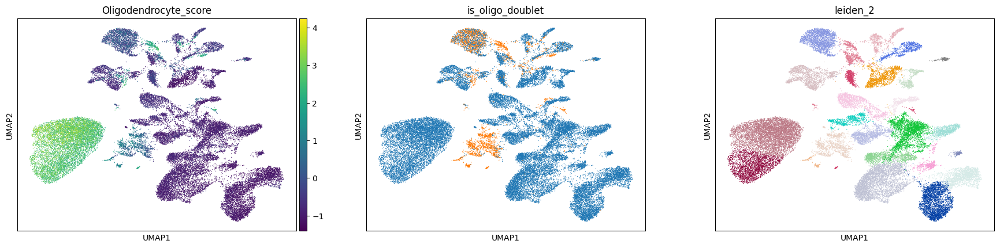

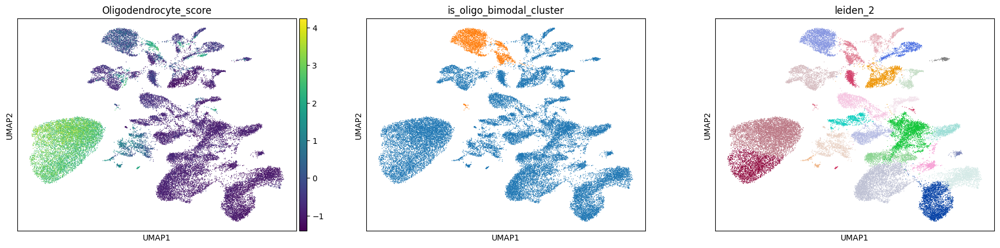

In [31]:
# define doublets by oligo score
    # 1) they are not real oligos (not in REAL_OLIGO_CLUSTERS)
    # 2) their oligo score is above the threshold 
        # defined for their cluster ?
        # mean of all thresholds --> OK

mean_threshold = results_df[(results_df['Is_Bimodal']) & (~results_df["Cluster"].isin(REAL_OLIGO_CLUSTERS))]['Threshold'].mean()
print("Mean thr: ", mean_threshold)

# if the cell belodsn to a bimodal cluster
adata.obs["is_oligo_bimodal_cluster"] = [
    not pd.isna(thresholds_dict.get(cl, np.nan)) 
    for cl in adata.obs[cluster_col]
]

adata.obs["is_oligo_doublet"] = [
    (adata.obs.loc[cell, score_col_oligo] >= mean_threshold)
    and (adata.obs.loc[cell, cluster_col] not in REAL_OLIGO_CLUSTERS)
    for cell in adata.obs_names
]

# if we want to use cluster-specific thresholds
# adata.obs['cluster_threshold'] = adata.obs[cluster_col].map(thresholds_dict)
# adata.obs["is_oligo_doublet"] = (
#     ~adata.obs[cluster_col].isin(REAL_OLIGO_CLUSTERS) &  # NOT real oligo
#     (adata.obs[score_col_oligo] >= adata.obs['cluster_threshold'])  # Above CLUSTER-SPECIFIC threshold
# )

print("\nDoublets distribution:")
print(adata.obs["is_oligo_doublet"].value_counts())
print("\nDoublets percentage:")
print(adata.obs["is_oligo_doublet"].value_counts().div(len(adata)))


sc.pl.umap(adata, color=[score_col_oligo, 'is_oligo_doublet', cluster_col], gene_symbols="gene_symbol", ncols=3, legend_loc=None)
sc.pl.umap(adata, color=[score_col_oligo, 'is_oligo_bimodal_cluster', cluster_col], gene_symbols="gene_symbol", ncols=3, legend_loc=None)


## Filter

In [32]:
# for this case we use only is oligo_doublet
adata.obs["is_doublet"] = adata.obs["is_oligo_doublet"]


print("\nDoublets distribution:")
print(adata.obs["is_doublet"].value_counts())
print("\nDoublets percentage:")
print(adata.obs["is_doublet"].value_counts().div(len(adata)))


Doublets distribution:
is_doublet
False    32200
True      3376
Name: count, dtype: int64

Doublets percentage:
is_doublet
False    0.905105
True     0.094895
Name: count, dtype: float64


In [33]:
print(adata)
adata = adata[~adata.obs["is_doublet"]].copy()
print(adata)

adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/doublets_filtered_adata.h5ad')

AnnData object with n_obs × n_vars = 35576 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

In [63]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/doublets_filtered_adata.h5ad')
adata

AnnData object with n_obs × n_vars = 32200 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

# Reprocess Clean Data

Normalizing...
Findingn HCGs...


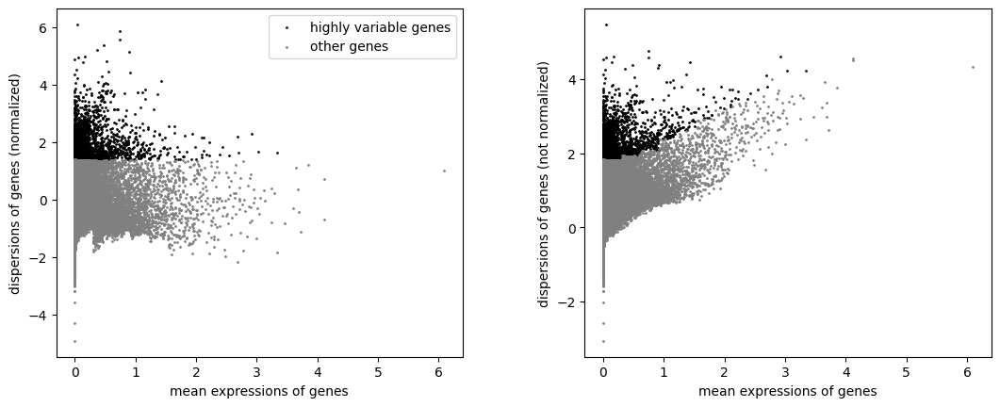

Scaling...


/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Calculating PCA...


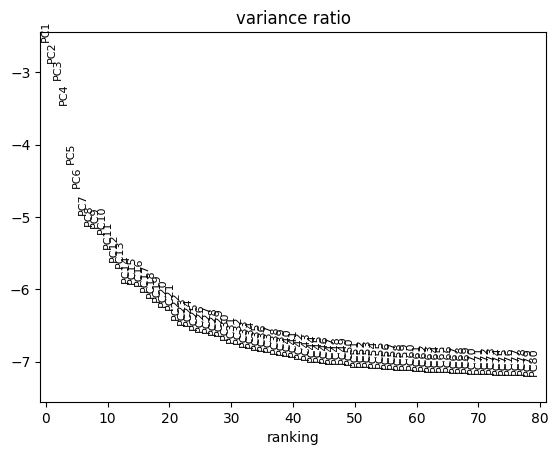

Calculating neightbors...
Calculating Umap...
Clutering...


In [69]:
# ATTENTION: bring bacj count
adata.X = adata.layers["counts"].copy()

# recalutle qc metrics (ex count_per_cell)
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

preprocessing.preprocess(adata, n_pcs_elbow=30, n_hvg=3000)

adata.write(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')
del(adata)

In [70]:
adata = sc.read_h5ad(f'/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-{LIBRARY}/adata/reprocessed_filtered_adata.h5ad')
adata

AnnData object with n_obs × n_vars = 32200 × 34115
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'dbscan_clusters', 'dbscan_score', 'has_spatial', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_1

# Metric by cluster

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


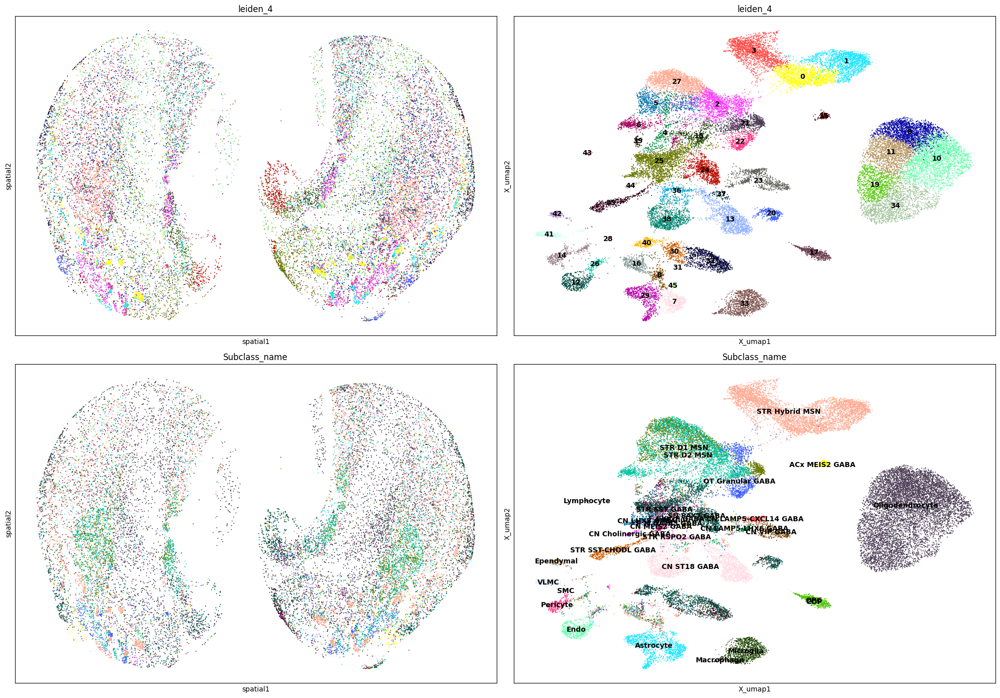

In [72]:
# Select level to investigaet
CLUSTER_LEVEL = "leiden_4"
ANNOTATION_LEVEL = "Subclass_name"

fig, axes = plt.subplots(2, 2, figsize=(20, 14))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate([CLUSTER_LEVEL, ANNOTATION_LEVEL]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None, size=8)
    sc.pl.embedding(adata, basis="X_umap", color=res, ax=axes[i,1], show=False, legend_fontsize=10, size=8, legend_loc="on data",)# legend_loc="lower center")

plt.tight_layout()
plt.show()

## Leiden clusters

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"{value_to_plot}_colors"] = colors_list


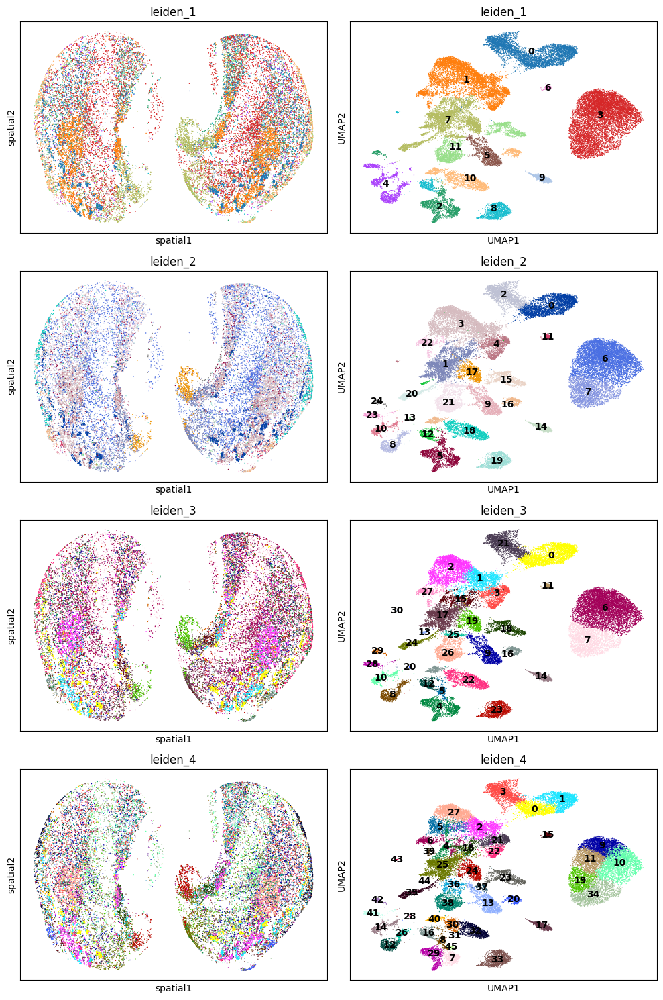

In [73]:
fig, axes = plt.subplots(4, 2, figsize=(10, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc="on data")

plt.tight_layout()
plt.show()

## QC metrics by cluster

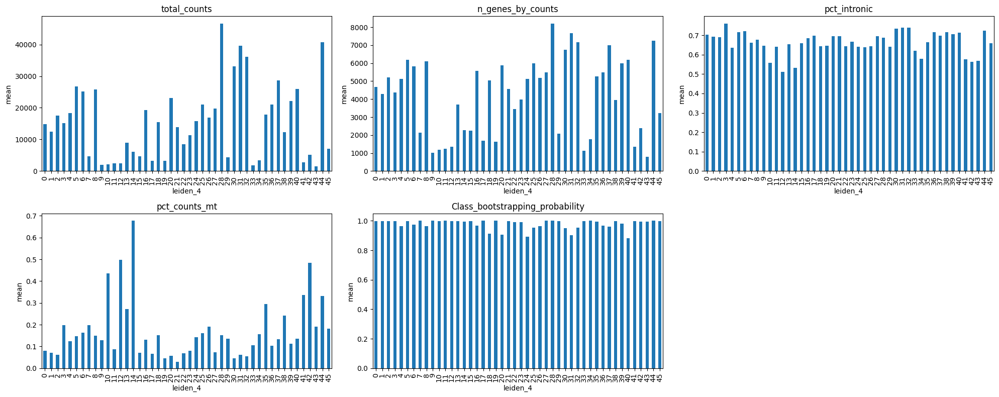

In [ ]:
# metrics = [
#     "total_counts",
#     "n_genes_by_counts",
#     "pct_intronic",
#     "pct_counts_mt",
#     "Class_bootstrapping_probability",
# ]

# # compute mean of each metric for each cluster
# df_means = (
#     adata.obs
#     .groupby(CLUSTER_LEVEL, observed=False)[metrics]
#     .mean()
#     .reset_index()
# )


# df_means = df_means.set_index(CLUSTER_LEVEL)
# # display(df_means)

# # Plot
# fig, axes = plt.subplots(2, 3, figsize=(20, 8))
# axes = axes.flatten()

# for ax, col in zip(axes, metrics):
#     df_means[col].plot(kind="bar", ax=ax)
#     ax.set_title(col)
#     ax.set_ylabel("mean")
#     ax.tick_params(axis="x")#, rotation=45)

# # hide any unused axes
# for ax in axes[len(metrics):]:
#     ax.set_visible(False)

# plt.tight_layout()
# plt.show()


# # sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data")


## UMI counts distribution by cluster

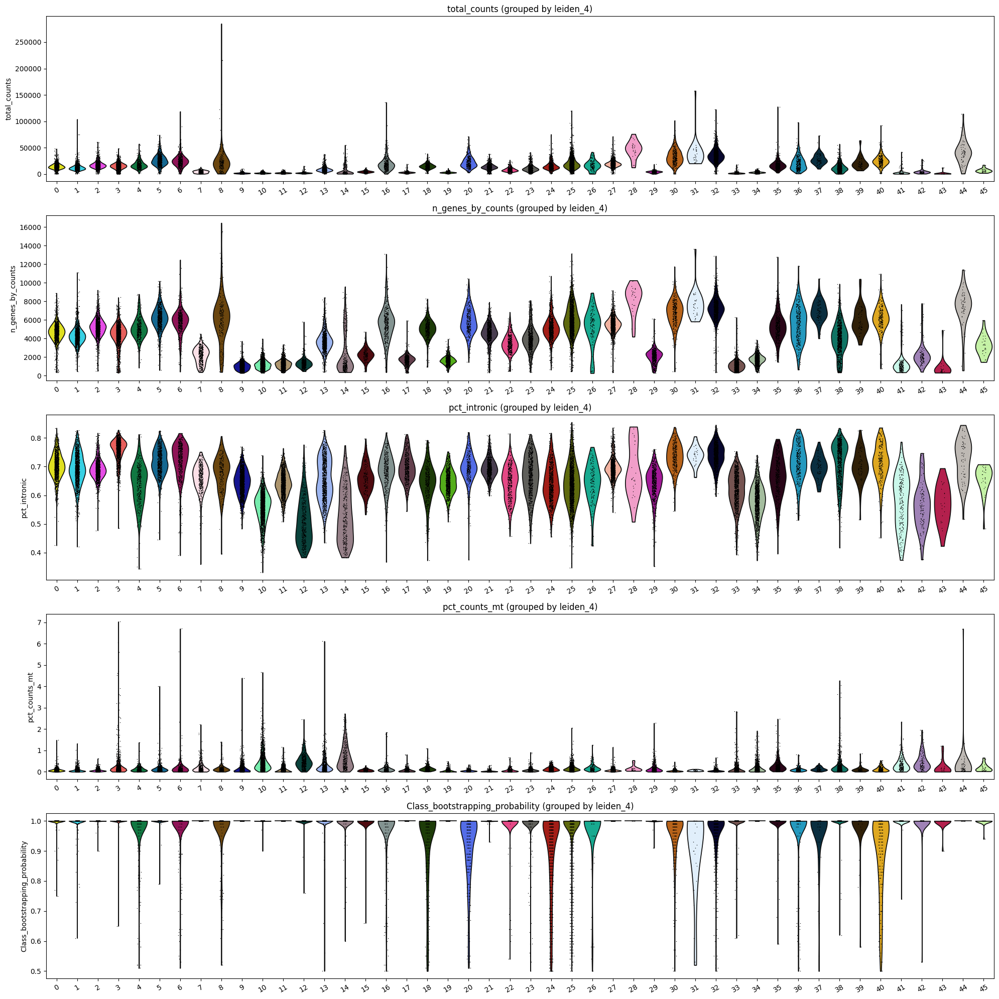

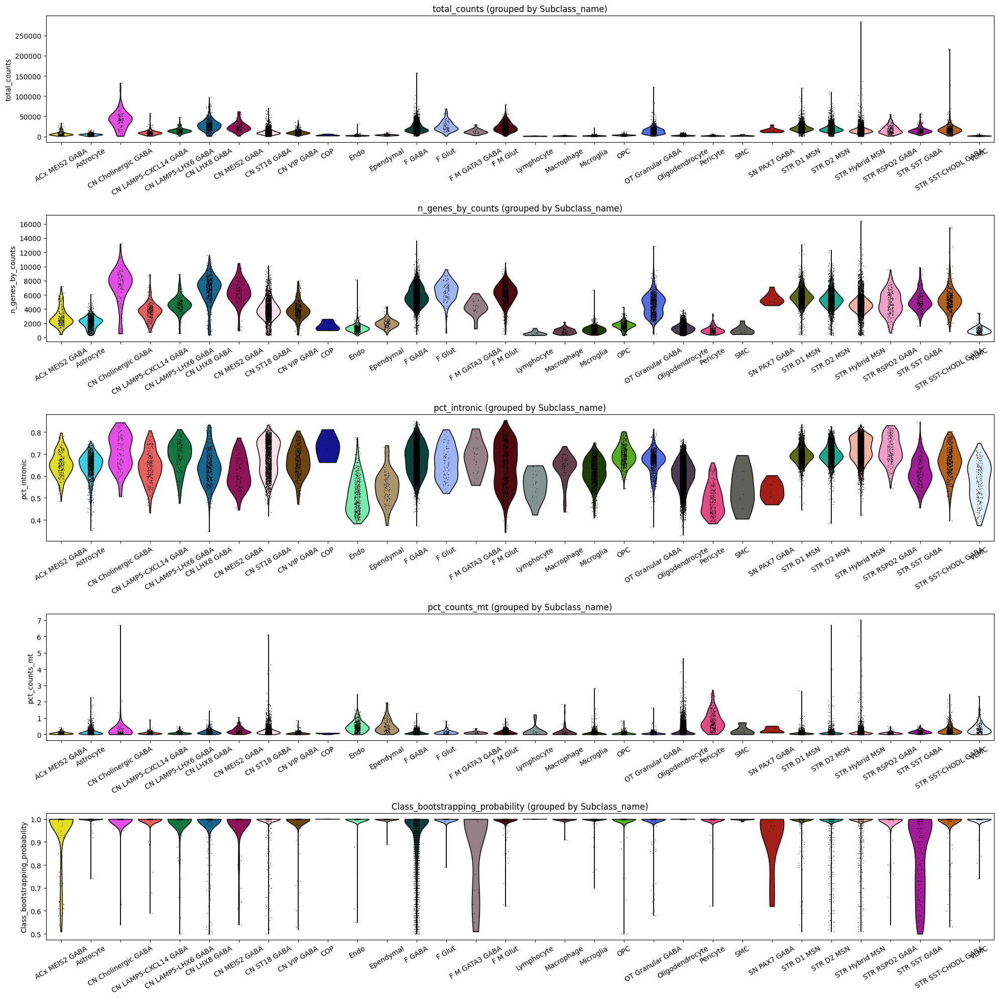

In [ ]:
metrics = [
    "total_counts",
    "n_genes_by_counts",
    "pct_intronic",
    # "pct_counts_mt",
    # "Class_bootstrapping_probability"
]

#############################
# FIGURE 1 — grouped by CLUSTER_LEVEL
#############################
fig1, axes1 = plt.subplots(
    nrows=len(metrics),
    ncols=1,
    figsize=(20, 4 * len(metrics))
)

for i, key in enumerate(metrics):
    sc.pl.violin(
        adata,
        keys=key,
        groupby=CLUSTER_LEVEL,
        rotation=30,
        ax=axes1[i],
        show=False
    )
    axes1[i].set_title(f"{key} (grouped by {CLUSTER_LEVEL})")

plt.tight_layout()
plt.show()


#############################
# FIGURE 2 — grouped by ANNOTATION_LEVEL
#############################
fig2, axes2 = plt.subplots(
    nrows=len(metrics),
    ncols=1,
    figsize=(20, 4 * len(metrics))
)

for i, key in enumerate(metrics):
    sc.pl.violin(
        adata,
        keys=key,
        groupby=ANNOTATION_LEVEL,
        rotation=30,
        ax=axes2[i],
        show=False
    )
    axes2[i].set_title(f"{key} (grouped by {ANNOTATION_LEVEL})")

plt.tight_layout()
plt.show()


In [ ]:
# HSIT DITRCIBTUON COUNT PER CLUSTER

# # Get unique clusters
# clusters = adata.obs[CLUSTER_LEVEL].unique()

# n_clusters = len(clusters)
# ncols = 5
# nrows = int(np.ceil(n_clusters / ncols))

# fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
# axes = axes.flatten()

# for idx, cluster in enumerate(clusters):
#     ax = axes[idx]
    
#     # Get data for this cluster
#     cluster_data = adata.obs[adata.obs[CLUSTER_LEVEL] == cluster]['total_counts']
    
#     # Plot histogram
#     ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
#     ax.set_title(f'Cluster {cluster}', fontweight='bold')
#     ax.set_xlabel('Total Counts')
#     ax.set_ylabel('# Cells')
    
#     # Add mean line
#     mean_val = cluster_data.mean()
#     ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
#                label=f'Mean: {mean_val:.0f}')
    
#     # Same x-axis for all
#     #ax.set_xlim(global_min, global_max)
#     ax.legend(fontsize=8)
#     ax.grid(alpha=0.3)

# # Hide unused subplots
# for idx in range(n_clusters, len(axes)):
#     axes[idx].axis('off')

# plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
# plt.tight_layout()
# plt.show()

## Cell Type distribution on Umap/spatial

/home/gdallagl/myworkdir/XDP/utils/preprocessing.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  from diptest import diptest


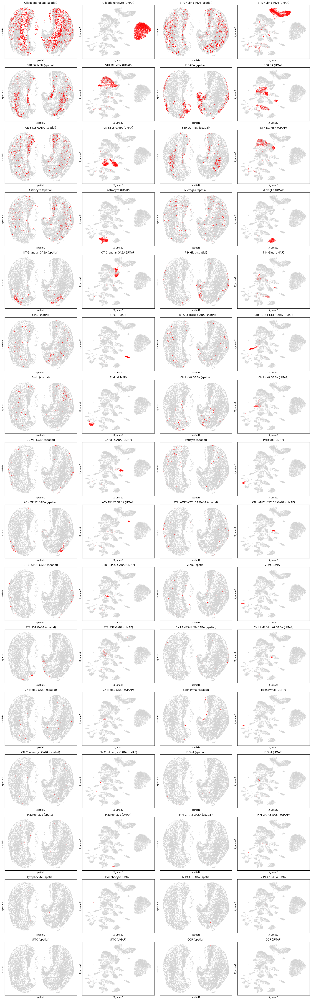

In [98]:
adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

preprocessing.plot_cell_type(adata, adata_spatial, ANNOTATION_LEVEL=ANNOTATION_LEVEL)

## Overall cell type distribution

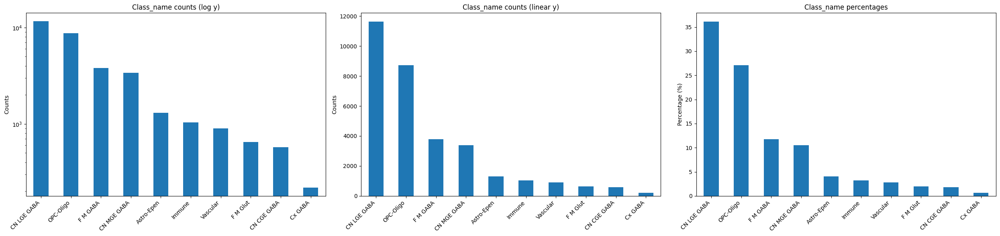

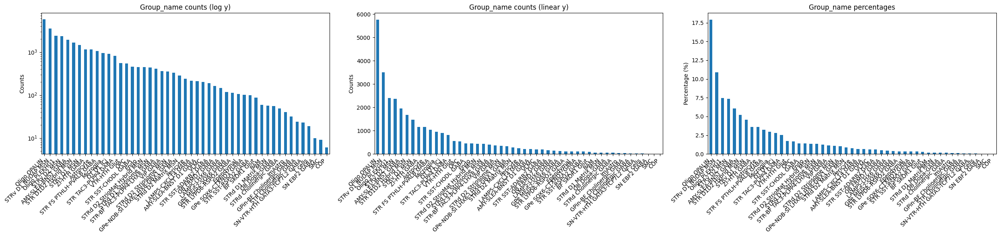

In [95]:
preprocessing.plot_cell_type_distribution(adata, annotation_levels=["Class_name", "Group_name"])

## Cell Type distribution by cluster

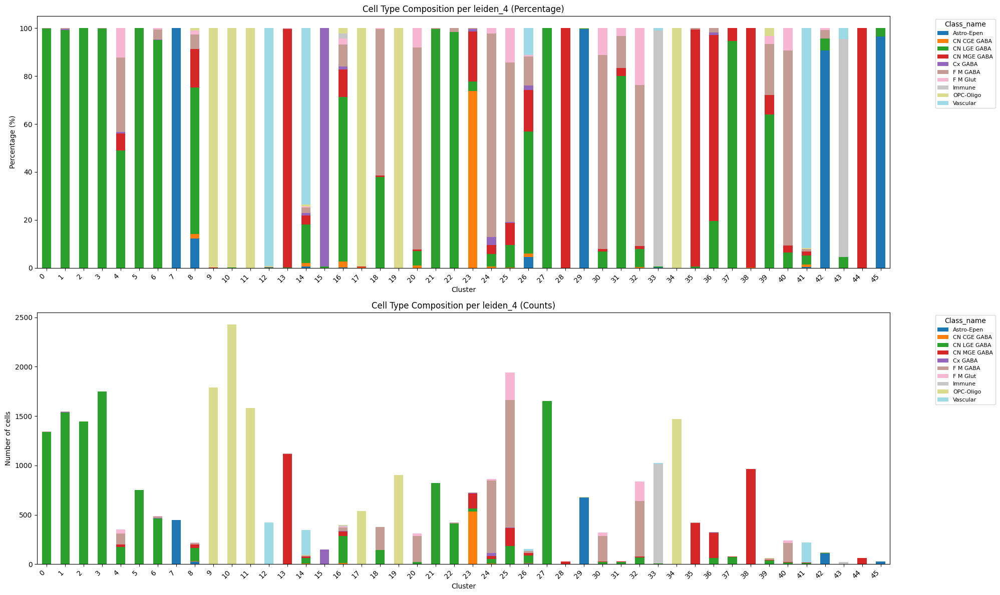

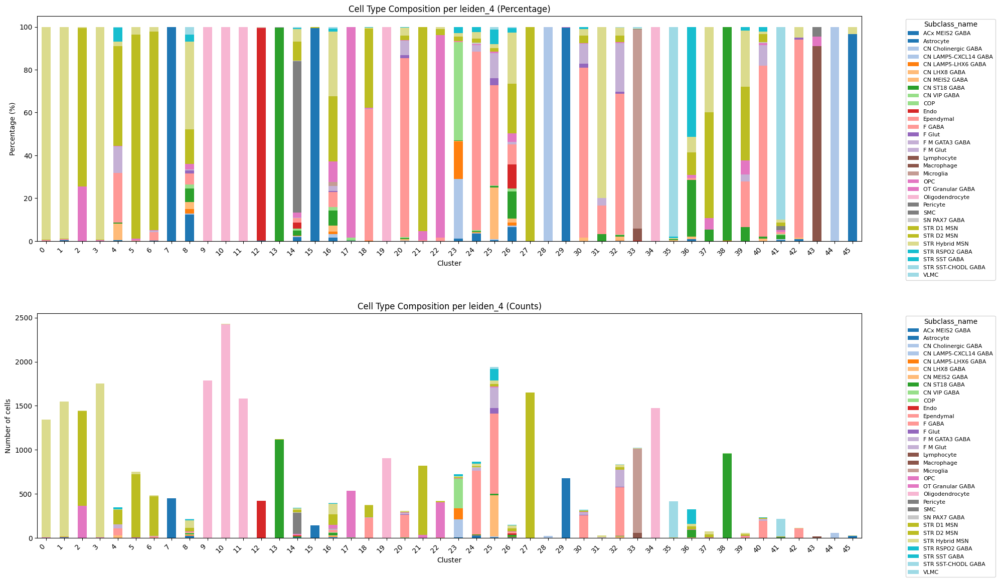

In [100]:
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Class_name", CLUSTER_LEVEL=CLUSTER_LEVEL)
preprocessing.plot_cell_type_distribution_per_cluster(adata, ANNOTATION_LEVEL="Subclass_name", CLUSTER_LEVEL=CLUSTER_LEVEL)

## MapMyCell cell types

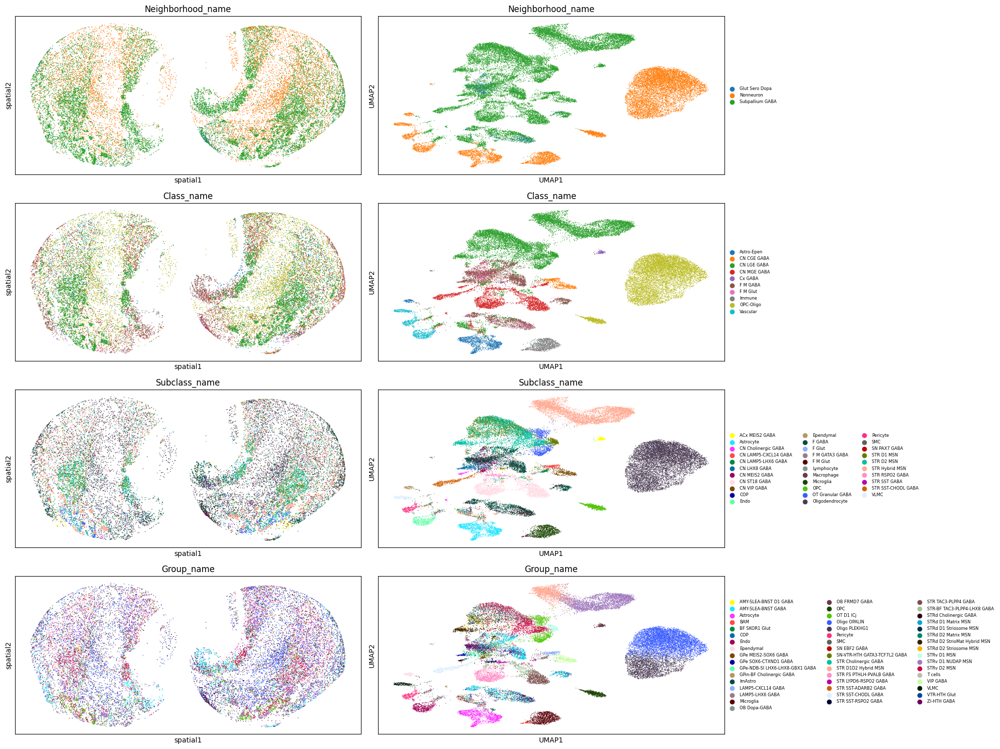

In [102]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

adata_spatial = ad.AnnData(X=csr_matrix(adata.X.shape),obs=adata.obs.copy(),var=adata.var.copy(),uns=adata.uns.copy(),obsm=adata.obsm.copy())
adata_spatial = adata_spatial[adata_spatial.obs.has_spatial]

for i, res in enumerate(["Neighborhood_name", "Class_name", "Subclass_name", "Group_name"]):
    sc.pl.embedding(adata_spatial, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

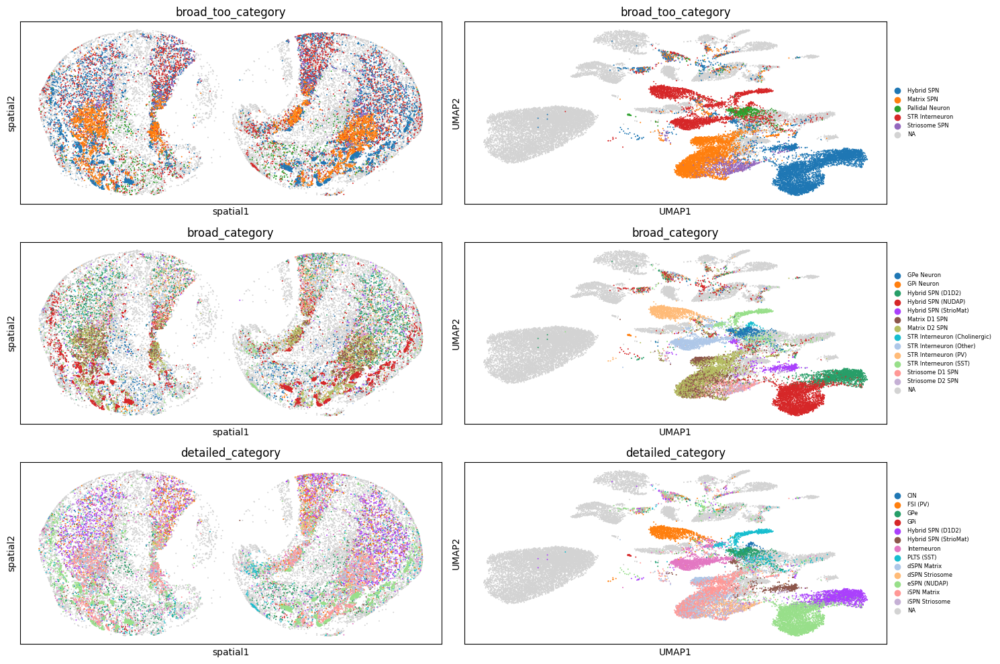

In [148]:
CELLTYPE_TO_BROAD_CATEGORY = {
    # Matrix SPNs
    'STRd D1 Matrix MSN': 'Matrix D1 SPN',
    'STRd D2 Matrix MSN': 'Matrix D2 SPN',
    'STRv D1 MSN': 'Matrix D1 SPN',  # Ventral is mostly matrix
    'STRv D2 MSN': 'Matrix D2 SPN',
    
    # Striosome SPNs
    'STRd D1 Striosome MSN': 'Striosome D1 SPN',
    'STRd D2 Striosome MSN': 'Striosome D2 SPN',
    
    # Hybrid SPNs (special populations)
    'STRv D1 NUDAP MSN': 'Hybrid SPN (NUDAP)',
    'STR D1D2 Hybrid MSN': 'Hybrid SPN (D1D2)',
    'STRd D2 StrioMat Hybrid MSN': 'Hybrid SPN (StrioMat)',
    
    # Striatal interneurons - SST subtypes
    'STR SST-CHODL GABA': 'STR Interneuron (SST)',
    'STR SST-RSPO2 GABA': 'STR Interneuron (SST)',
    'STR SST-ADARB2 GABA': 'STR Interneuron (SST)',
    
    # Striatal interneurons - Fast-spiking (PV)
    'STR FS PTHLH-PVALB GABA': 'STR Interneuron (PV)',
    
    # Striatal interneurons - Other GABAergic
    'STR TAC3-PLPP4 GABA': 'STR Interneuron (Other)',
    'STR LYPD6-RSPO2 GABA': 'STR Interneuron (Other)',
    'STR-BF TAC3-PLPP4-LHX8 GABA': 'STR Interneuron (Other)',
    
    # Cholinergic interneurons
    'STRd Cholinergic GABA': 'STR Interneuron (Cholinergic)',
    'STR Cholinergic GABA': 'STR Interneuron (Cholinergic)',
    
    # Globus Pallidus External
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA': 'GPe Neuron',
    'GPe MEIS2-SOX6 GABA': 'GPe Neuron',
    'GPe SOX6-CTXND1 GABA': 'GPe Neuron',
    
    # Globus Pallidus Internal
    'GPin-BF Cholinergic GABA': 'GPi Neuron',
    
    # Non-neuronal
    'Astrocyte': np.nan,
    'Oligo OPALIN': np.nan,
    'Oligo PLEKHG1': np.nan,
    'Microglia': np.nan,
    'OPC': np.nan,
    'ImOligo': np.nan,
    'Pericyte': np.nan,
    'Endo': np.nan,
}
CELLTYPE_TO_DETAILED_CATEGORY = {
    # Matrix SPNs - Direct pathway (D1)
    'STRd D1 Matrix MSN': 'dSPN Matrix',
    'STRv D1 MSN': 'dSPN Matrix',
    
    # Matrix SPNs - Indirect pathway (D2)
    'STRd D2 Matrix MSN': 'iSPN Matrix',
    'STRv D2 MSN': 'iSPN Matrix',
    
    # Striosome SPNs - Direct pathway (D1)
    'STRd D1 Striosome MSN': 'dSPN Striosome',
    
    # Striosome SPNs - Indirect pathway (D2)
    'STRd D2 Striosome MSN': 'iSPN Striosome',
    
    # Hybrid SPNs
    'STRv D1 NUDAP MSN': 'eSPN (NUDAP)',  # "eccentric" SPN
    'STR D1D2 Hybrid MSN': 'Hybrid SPN (D1D2)',
    'STRd D2 StrioMat Hybrid MSN': 'Hybrid SPN (StrioMat)',
    
    # Interneurons
    'STR SST-CHODL GABA': 'PLTS (SST)',
    'STR SST-RSPO2 GABA': 'PLTS (SST)',
    'STR SST-ADARB2 GABA': 'PLTS (SST)',
    'STR FS PTHLH-PVALB GABA': 'FSI (PV)',
    'STR TAC3-PLPP4 GABA': 'Interneuron',
    'STR LYPD6-RSPO2 GABA': 'Interneuron',
    'STR-BF TAC3-PLPP4-LHX8 GABA': 'Interneuron',
    'STRd Cholinergic GABA': 'CIN',
    'STR Cholinergic GABA': 'CIN',
    
    # Pallidal neurons
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA': 'GPe',
    'GPe MEIS2-SOX6 GABA': 'GPe',
    'GPe SOX6-CTXND1 GABA': 'GPe',
    'GPin-BF Cholinergic GABA': 'GPi',
    
    # Non-neuronal
    'Astrocyte': np.nan,
    'Oligo OPALIN': np.nan,
    'Oligo PLEKHG1': np.nan,
    'Microglia': np.nan,
    'OPC': np.nan,
    'ImOligo': np.nan,
    'Pericyte': np.nan,
    'Endo': np.nan,
}

CELLTYPE_TOO_BROAD = {
    # Matrix SPNs (both D1 and D2)
    'STRd D1 Matrix MSN': 'Matrix SPN',
    'STRd D2 Matrix MSN': 'Matrix SPN',
    'STRv D1 MSN': 'Matrix SPN',
    'STRv D2 MSN': 'Matrix SPN',
    
    # Striosome SPNs (both D1 and D2)
    'STRd D1 Striosome MSN': 'Striosome SPN',
    'STRd D2 Striosome MSN': 'Striosome SPN',
    
    # All Hybrid SPNs
    'STRv D1 NUDAP MSN': 'Hybrid SPN',
    'STR D1D2 Hybrid MSN': 'Hybrid SPN',
    'STRd D2 StrioMat Hybrid MSN': 'Hybrid SPN',
    
    # All Striatal Interneurons
    'STR SST-CHODL GABA': 'STR Interneuron',
    'STR SST-RSPO2 GABA': 'STR Interneuron',
    'STR SST-ADARB2 GABA': 'STR Interneuron',
    'STR FS PTHLH-PVALB GABA': 'STR Interneuron',
    'STR TAC3-PLPP4 GABA': 'STR Interneuron',
    'STR LYPD6-RSPO2 GABA': 'STR Interneuron',
    'STR-BF TAC3-PLPP4-LHX8 GABA': 'STR Interneuron',
    'STRd Cholinergic GABA': 'STR Interneuron',
    'STR Cholinergic GABA': 'STR Interneuron',
    
    # All Pallidal neurons
    'GPe-NDB-SI LHX6-LHX8-GBX1 GABA': 'Pallidal Neuron',
    'GPe MEIS2-SOX6 GABA': 'Pallidal Neuron',
    'GPe SOX6-CTXND1 GABA': 'Pallidal Neuron',
    'GPin-BF Cholinergic GABA': 'Pallidal Neuron',
    
    # Non-neuronal → NaN
    'Astrocyte': np.nan,
    'Oligo OPALIN': np.nan,
    'Oligo PLEKHG1': np.nan,
    'Microglia': np.nan,
    'OPC': np.nan,
    'ImOligo': np.nan,
    'Pericyte': np.nan,
    'Endo': np.nan,
}

adata.obs['broad_category'] = adata.obs['Group_name'].map(CELLTYPE_TO_BROAD_CATEGORY)
adata.obs['broad_too_category'] = adata.obs['Group_name'].map(CELLTYPE_TOO_BROAD)
adata.obs['detailed_category'] = adata.obs['Group_name'].map(CELLTYPE_TO_DETAILED_CATEGORY)

# sc.pl.umap(adata, color=['Group_name', 'broad_category', 'detailed_category'], 
#            ncols=3, legend_loc='on data', legend_fontsize=6)


fig, axes = plt.subplots(3, 2, figsize=(15, 10))

for i, res in enumerate(['broad_too_category', 'broad_category', 'detailed_category']):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i, 0], show=False, legend_loc=None, size=8)
    sc.pl.umap(adata, color=res, ax=axes[i, 1], show=False, legend_fontsize=6, size=8)

plt.tight_layout()
plt.show()